# Problem statement: 
## What are the key factors contributing to the career and job satisfaction of developers, which could lead to a higher retention rate of development resources in the IT industry?

# Notebook context

Our business case aims at finding correlations between the career satisfaction levels experienced by developers and other aspects of their proffesional life. 
If such correlations is to be found, the results can be used as key factors in solving the problem of recruiting and retaining a company's development resources for a longer period of time. 
In order to answer this question, in this notebook we will examine data collected from the Stack Overflow survey information.
Since Stack Overflow describes themselves as "the largest, most trusted online community for developers"(1), we believe the data is already comming from a reliable source. This data was made public on Kaggle, accessible on the following link: https://www.kaggle.com/mchirico/stack-overflow-developer-survey-results-2019
    
In this notebook we will attempt at observing the following points:
1. Exploratory data analysis
2. Cleaning and transforming the data
3. Testing the cleaned data against a linear regression model
4. Building a machine learning classification model
5. Evaluating the model and the results obtained
   
References:

(1):https://stackoverflow.com/

## Exploratory Data Analysis

In [1]:
library(tidyverse)
library(dplyr)

Registered S3 methods overwritten by 'ggplot2':
  method         from 
  [.quosures     rlang
  c.quosures     rlang
  print.quosures rlang
Registered S3 method overwritten by 'rvest':
  method            from
  read_xml.response xml2
-- Attaching packages --------------------------------------- tidyverse 1.2.1 --
v ggplot2 3.1.1       v purrr   0.3.2  
v tibble  2.1.1       v dplyr   0.8.0.1
v tidyr   0.8.3       v stringr 1.4.0  
v readr   1.3.1       v forcats 0.4.0  
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks stats::filter()
x dplyr::lag()    masks stats::lag()


#### Loading data from the original source file

The selected dataset contains 85 answer categories from the respondends. Each or more could be relevant factors in influencing the career satisfaction of the respondends.
Below, we are loading the data set by reading it from the source file, showing the size / dimensions with the help of the dim function as well as a small sample of the data retrieved from the source file (making use of the head function).

In [2]:
data2019 <- read.csv("survey_results_public-2019.csv", stringsAsFactors=FALSE)
dim(data2019)
head(data2019, 5)

[1] 88883    85

Respondent,MainBranch,Hobbyist,OpenSourcer,OpenSource,Employment,Country,Student,EdLevel,UndergradMajor,...,WelcomeChange,SONewContent,Age,Gender,Trans,Sexuality,Ethnicity,Dependents,SurveyLength,SurveyEase
1,I am a student who is learning to code,Yes,Never,The quality of OSS and closed source software is about the same,"Not employed, and not looking for work",United Kingdom,No,Primary/elementary school,NA,...,Just as welcome now as I felt last year,Tech articles written by other developers;Industry news about technologies you're interested in;Courses on technologies you're interested in,14,Man,No,Straight / Heterosexual,NA,No,Appropriate in length,Neither easy nor difficult
2,I am a student who is learning to code,No,Less than once per year,The quality of OSS and closed source software is about the same,"Not employed, but looking for work",Bosnia and Herzegovina,"Yes, full-time","Secondary school (e.g. American high school, German Realschule or Gymnasium, etc.)",NA,...,Just as welcome now as I felt last year,Tech articles written by other developers;Industry news about technologies you're interested in;Tech meetups or events in your area;Courses on technologies you're interested in,19,Man,No,Straight / Heterosexual,NA,No,Appropriate in length,Neither easy nor difficult
3,"I am not primarily a developer, but I write code sometimes as part of my work",Yes,Never,The quality of OSS and closed source software is about the same,Employed full-time,Thailand,No,"Bachelorâ€™s degree (BA, BS, B.Eng., etc.)",Web development or web design,...,Just as welcome now as I felt last year,Tech meetups or events in your area;Courses on technologies you're interested in,28,Man,No,Straight / Heterosexual,NA,Yes,Appropriate in length,Neither easy nor difficult
4,I am a developer by profession,No,Never,The quality of OSS and closed source software is about the same,Employed full-time,United States,No,"Bachelorâ€™s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or software engineering",...,Just as welcome now as I felt last year,Tech articles written by other developers;Industry news about technologies you're interested in;Tech meetups or events in your area;Courses on technologies you're interested in,22,Man,No,Straight / Heterosexual,White or of European descent,No,Appropriate in length,Easy
5,I am a developer by profession,Yes,Once a month or more often,"OSS is, on average, of HIGHER quality than proprietary / closed source software",Employed full-time,Ukraine,No,"Bachelorâ€™s degree (BA, BS, B.Eng., etc.)","Computer science, computer engineering, or software engineering",...,Just as welcome now as I felt last year,Tech meetups or events in your area;Courses on technologies you're interested in,30,Man,No,Straight / Heterosexual,White or of European descent;Multiracial,No,Appropriate in length,Easy


In [3]:
str(data2019)

'data.frame':	88883 obs. of  85 variables:
 $ Respondent            : int  1 2 3 4 5 6 7 8 9 10 ...
 $ MainBranch            : chr  "I am a student who is learning to code" "I am a student who is learning to code" "I am not primarily a developer, but I write code sometimes as part of my work" "I am a developer by profession" ...
 $ Hobbyist              : chr  "Yes" "No" "Yes" "No" ...
 $ OpenSourcer           : chr  "Never" "Less than once per year" "Never" "Never" ...
 $ OpenSource            : chr  "The quality of OSS and closed source software is about the same" "The quality of OSS and closed source software is about the same" "The quality of OSS and closed source software is about the same" "The quality of OSS and closed source software is about the same" ...
 $ Employment            : chr  "Not employed, and not looking for work" "Not employed, but looking for work" "Employed full-time" "Employed full-time" ...
 $ Country               : chr  "United Kingdom" "Bosnia and Herzegov

By using the str() function, it can be observed that the data consists only of integers, numeric (double) and chr (text/ string). Since many values belonging to our observations contain chr type values, they will require further transformation.

In [4]:
bad_data_YearsCode <- str_subset(data2019$YearsCode, "[a-z A-Z]")
bad_data_Age1stCode <- str_subset(data2019$Age1stCode, "[a-z A-Z]")
bad_data_YearsCode
bad_data_Age1stCode

[1] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
   [4] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
   [7] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [10] "Less than 1 year"   "Less than 1 year"   "More than 50 years"
  [13] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [16] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [19] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [22] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [25] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [28] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [31] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [34] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [37] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [40] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [43] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [46] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [49] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [52] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [55] "Less than 1 year"   "More than 50 years" "Less than 1 year"  
  [58] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [61] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [64] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [67] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [70] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [73] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [76] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [79] "Less than 1 year"   "More than 50 years" "Less than 1 year"  
  [82] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [85] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [88] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [91] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [94] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
  [97] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [100] "Less than 1 year"   "Less than 1 year"   "More than 50 years"
 [103] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [106] "Less than 1 year"   "More than 50 years" "Less than 1 year"  
 [109] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [112] "Less than 1 year"   "More than 50 years" "Less than 1 year"  
 [115] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [118] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [121] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [124] "Less than 1 year"   "More than 50 years" "More than 50 years"
 [127] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [130] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [133] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [136] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [139] "Less than 1 year"   "More than 50 years" "More than 50 years"
 [142] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [145] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [148] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [151] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [154] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [157] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [160] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [163] "Less than 1 year"   "Less than 1 year"   "Less than 1 year"  
 [166] "Less than 1 year"   "More than 50 years" "Less than 1 year"  
 [169] "More than 50 years" "Less than 1 year"   "Less than 1 year"  
 [172] "Less 

[1] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
  [4] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
  [7] "Younger than 5 years" "Younger than 5 years" "Older than 85"       
 [10] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [13] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [16] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [19] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [22] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [25] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [28] "Younger than 5 years" "Older than 85"        "Younger than 5 years"
 [31] "Older than 85"        "Younger than 5 years" "Younger than 5 years"
 [34] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [37] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [40] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [43] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [46] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [49] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [52] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [55] "Older than 85"        "Younger than 5 years" "Younger than 5 years"
 [58] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [61] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [64] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [67] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [70] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [73] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [76] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [79] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [82] "Younger than 5 years" "Older than 85"        "Younger than 5 years"
 [85] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [88] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [91] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [94] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
 [97] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[100] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[103] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[106] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[109] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[112] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[115] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[118] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[121] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[124] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[127] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[130] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[133] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[136] "Younger than 5 years" "Younger than 5 years" "Older than 85"       
[139] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[142] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[145] "Younger than 5 years" "Older than 85"        "Younger than 5 years"
[148] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[151] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[154] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[157] "Younger than 5 years" "Younger than 5 years" "Younger than 5 years"
[160] "Younger than 5 years

Running the above code shows that these observations must return string values since they contain both numbers (the exact number of years) and strings (approximation like "less than 1 year", "more than 50 years", etc.). Therefore, the reason behind these columns being of type chr is now made clear. 

Another interesting thing that can be observed is placed in the Age1stCode columns where the bad_data_Age1stCode shows that some responses selected "Older that 85" as the age when they first started coding. 
This is a bit suspicious from our point of view, since in a lot of countries, 85 year old people are retired for a while, hence the chances of them engaging in coding might be low. 

Therefore, below we will filter the current data2019 table against this value in order to see more information regarding the respondednts that have this characteristic. 

In [5]:
age1stCodeTable <- filter(data2019, Age1stCode == "Older than 85")
dim(age1stCodeTable) 
select(age1stCodeTable, Respondent, EduOther, YearsCode, Age1stCode, Age, SOVisit1st, JobSeek, LastHireDate, WorkWeekHrs, WorkLoc)

[1] 26 85

Respondent,EduOther,YearsCode,Age1stCode,Age,SOVisit1st,JobSeek,LastHireDate,WorkWeekHrs,WorkLoc
840,NA,More than 50 years,Older than 85,NA,2019,I am actively looking for a job,NA - I am an independent contractor or self employed,NA,NA
5180,"Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder)",13,Older than 85,NA,2018,NA,NA,NA,NA
5417,"Taken an online course in programming or software development (e.g. a MOOC);Participated in a full-time developer training program or bootcamp;Taken a part-time in-person course in programming or software development;Completed an industry certification program (e.g. MCPD);Received on-the-job training in software development;Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon;Contributed to open source software",More than 50 years,Older than 85,NA,I don't remember,NA,NA,NA,NA
8657,Taken an online course in programming or software development (e.g. a MOOC);Taken a part-time in-person course in programming or software development,2,Older than 85,30,2017,NA,NA,NA,NA
12310,Contributed to open source software,More than 50 years,Older than 85,NA,2019,NA,NA,NA,NA
20714,"Taught yourself a new language, framework, or tool without taking a formal course",4,Older than 85,22,NA,I am not interested in new job opportunities,More than 4 years ago,40,Office
21763,"Received on-the-job training in software development;Taught yourself a new language, framework, or tool without taking a formal course",15,Older than 85,NA,2014,I am actively looking for a job,NA - I am an independent contractor or self employed,NA,NA
32403,"Taken an online course in programming or software development (e.g. a MOOC);Participated in a full-time developer training program or bootcamp;Taken a part-time in-person course in programming or software development;Completed an industry certification program (e.g. MCPD);Received on-the-job training in software development;Taught yourself a new language, framework, or tool without taking a formal course;Participated in online coding competitions (e.g. HackerRank, CodeChef, TopCoder);Participated in a hackathon;Contributed to open source software",More than 50 years,Older than 85,NA,NA,"Iâ€™m not actively looking, but I am open to new opportunities",1-2 years ago,NA,Home
34973,NA,More than 50 years,Older than 85,99,2019,NA,NA,NA,NA
41427,Taken an online course in programming or software development (e.g. a MOOC),50,Older than 85,NA,2019,I am actively looking for a job,Less than a year ago,NA,"Other place, such as a coworking space or cafe"


In cell above, the variable age1stCodeTable contains a filtering of the current data based on the "Older than 85" values while dim(age1stCodeTable) is showing that there are 26 observations (rows) with this information in the Age1stCode variable (column).

As we can clearly see in the record of respondent 840, 12310 and many others, they state that they have been coding for more than 50 years (YearsCode column) and the age they first started coding was older than 85 (Years1stCode column). The best case scenario would be that these people were 135 years old in the time this survey took place. We think it's safe to assume that some of the questions in this survey might have been misunderstood or answered dishonestly, and therefore should be treated carefully in further calculations.

Both the above and below cells show certain columns of the age1stCodeTable that help us understand if these observations are trustwrthy or by convenience could also just be excluded in order to simplify the data cleaning process from here. Yet we choose to keep them because they might contain accurate data.

Since our data is dealing with a lot peoples' opinion and career lives, it's important to get a rough overview of the people participating in the survey. The cell below clearly illustrates that the number of men in this survey was substantially higher than the number of women (and people without providing specific gender information or other cases). This might be explained by the fact that the software development industry is still highly dominated by men.

In [6]:
data2019 %>% group_by(Gender) %>% summarize(Count=n()) %>% arrange(desc(Count))

Gender,Count
Man,77919
Woman,6344
NA,3477
"Non-binary, genderqueer, or gender non-conforming",597
"Man;Non-binary, genderqueer, or gender non-conforming",181
"Woman;Non-binary, genderqueer, or gender non-conforming",163
Woman;Man,132
"Woman;Man;Non-binary, genderqueer, or gender non-conforming",70


The overview and counts of peoples' experience with coding can be found below. It seems that most people in the survey picked up coding somewhere between 4 and 10 years.

In [7]:
data2019 %>% group_by(YearsCode) %>% summarize(Count=n()) %>% arrange(desc(Count))

YearsCode,Count
5,7047
10,6777
6,6179
4,5729
8,5361
7,5320
3,5179
2,3974
15,3942
20,3636


Warning message in eval(expr, envir, enclos):
"NAs introduced by coercion"

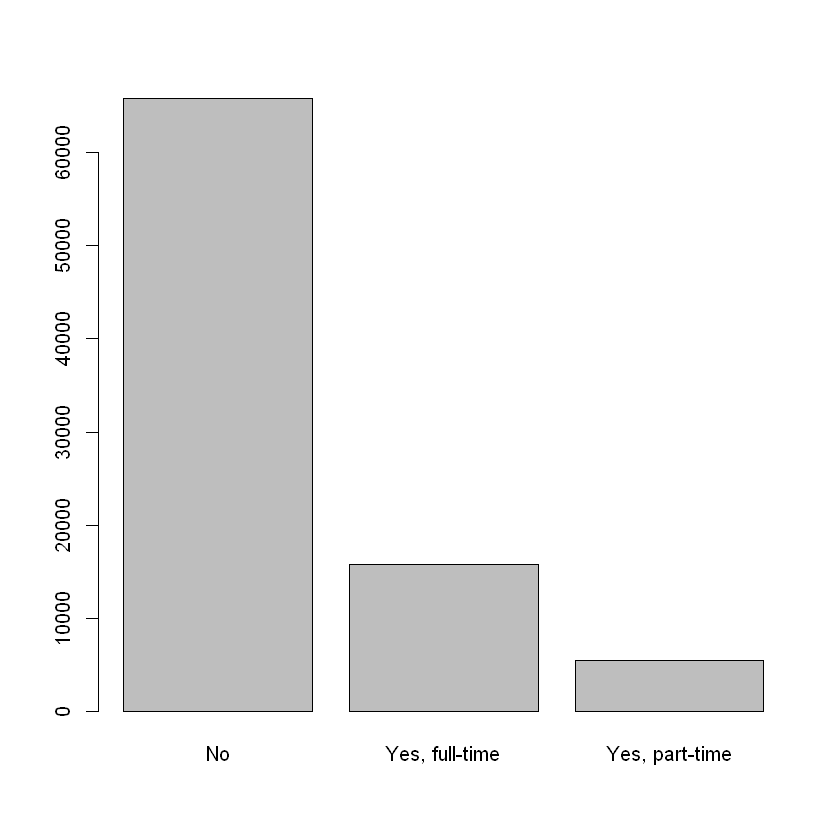

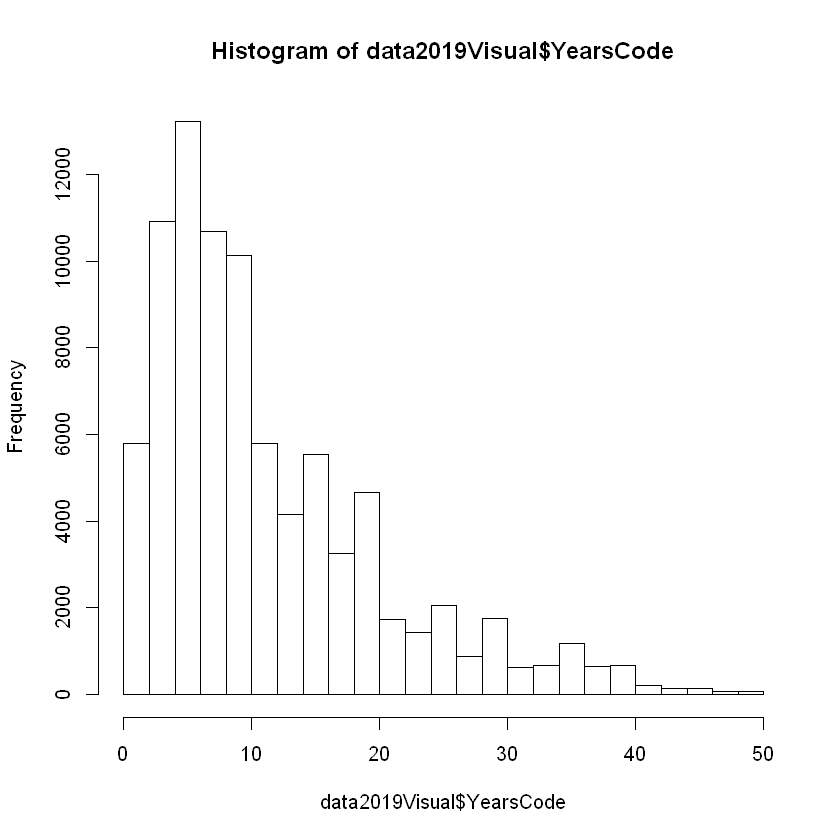

In [8]:
data2019Visual <- data2019
data2019Visual$Student <- as.factor(data2019Visual$Student)
plot(data2019Visual$Student)
data2019Visual$YearsCode <- as.numeric(data2019Visual$YearsCode)
hist(data2019Visual$YearsCode)

[1] 0.7816206

`geom_smooth()` using method = 'gam' and formula 'y ~ s(x, bs = "cs")'
Warning message:
"Removed 11050 rows containing non-finite values (stat_smooth)."Warning message:
"Removed 11050 rows containing missing values (geom_point)."

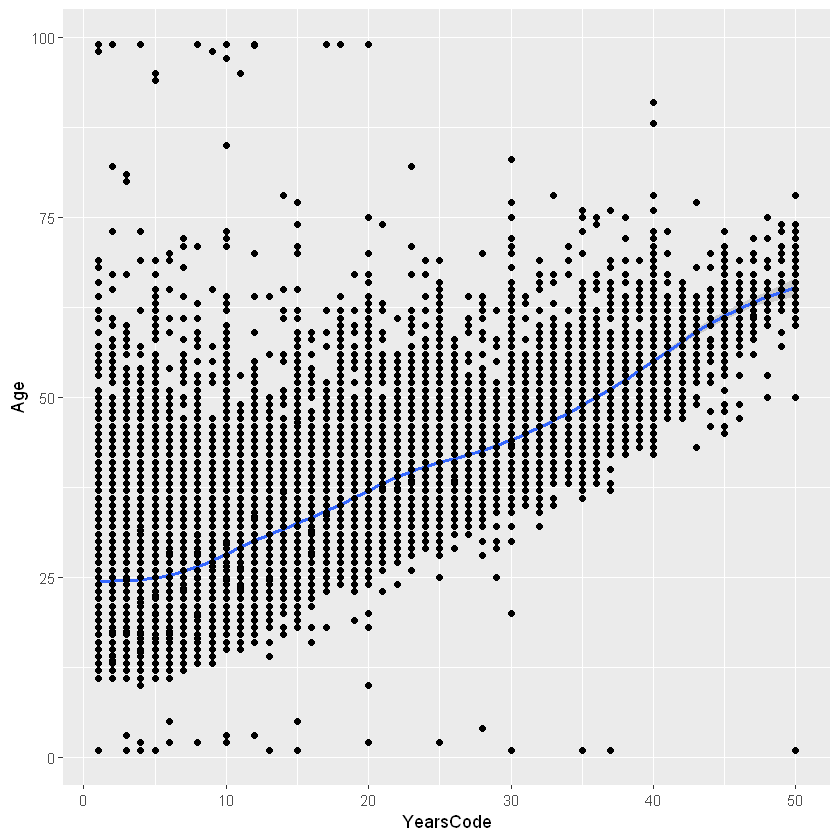

In [9]:
data2019Visual$Age <- as.numeric(data2019Visual$Age)
cor(data2019Visual$YearsCode, data2019Visual$Age,  method = "pearson", use = "complete.obs")
ggplot(data = data2019Visual) + geom_smooth(mapping = aes(x = YearsCode, y = Age)) + geom_point(mapping = aes(x = YearsCode, y = Age))

As expected, one can find a correlation between the people's age and the number of years they have been coding. The cell above presents the calculated value of Pearson's Correlation Coefficient and a scatter plot sketching this relationship. 

The cell below shows the number of answers under each recorded career satisfaction group. 

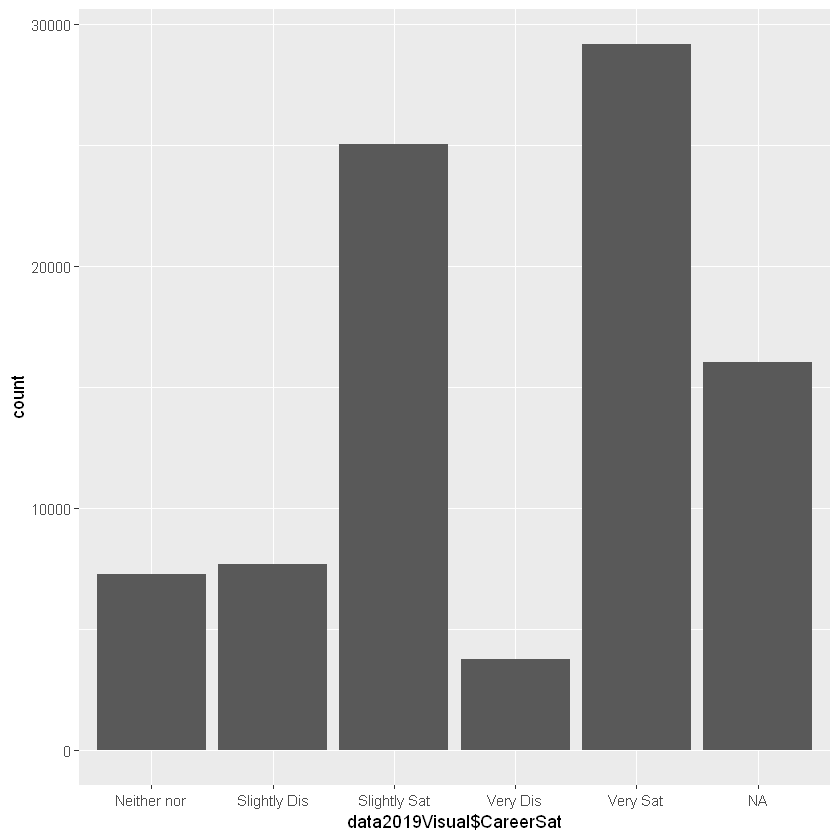

In [10]:
ggplot(data = data2019Visual, aes(data2019Visual$CareerSat)) + stat_count() + scale_x_discrete(labels = c("Very satisfied"="Very Sat", "Slightly satisfied" = "Slightly Sat", "Neither satisfied nor dissatisfied" = "Neither nor", "Slightly dissatisfied" = "Slightly Dis", "Very dissatisfied" = "Very Dis"))

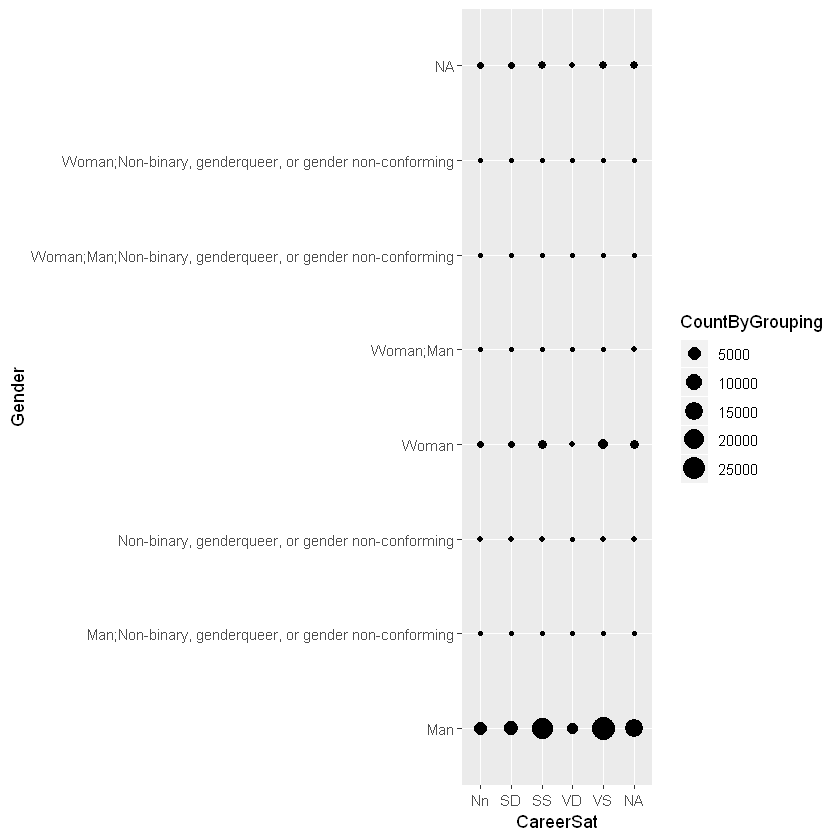

In [11]:
genderPlotData <- data2019 %>% group_by(CareerSat, Gender) %>% mutate(CountByGrouping = n())
ggplot(data = genderPlotData) + geom_point(mapping = aes(x = CareerSat, y = Gender, size=CountByGrouping)) + scale_x_discrete(labels = c("Very satisfied"="VS", "Slightly satisfied" = "SS", "Neither satisfied nor dissatisfied" = "Nn", "Slightly dissatisfied" = "SD", "Very dissatisfied" = "VD"))

The above plot was meant for showing a potential correlation between the gender and career satisfaction of an observation.
Instead what we can clearly see is that an observation can be more than just male or female, moreover this data will have to be handled later on in a more orderly manner in order to conclude the existance of a potential correlation. 

As a last point in this section, we inspect the satisfaction level of peoples' job (the first result) and then with their career (the second result). It is interesting that the 2 highest results are "Slightly satisfied" and "Very satisfied". However, we realize that our measurements might be biased to a certain degree and not apply to wider public, since we believe that people who participate in Stack Overflow survey are probably poeple who spend some time coding in their freetime - are hobbyists (as can be seen in the third result). That implies that people that enjoy coding might be more likely to be satisfied with their career. We will explore this point more thoroughly in the following sections.

In [12]:
data2019 %>% group_by(JobSat) %>% summarize(Count=n()) %>% arrange(desc(Count))
data2019 %>% group_by(CareerSat) %>% summarize(Count=n()) %>% arrange(desc(Count))
data2019 %>% group_by(Hobbyist) %>% summarize(Count=n()) %>% arrange(desc(Count))

JobSat,Count
Slightly satisfied,24207
Very satisfied,22452
NA,17895
Slightly dissatisfied,10752
Neither satisfied nor dissatisfied,8720
Very dissatisfied,4857


CareerSat,Count
Very satisfied,29173
Slightly satisfied,25018
NA,16036
Slightly dissatisfied,7670
Neither satisfied nor dissatisfied,7252
Very dissatisfied,3734


Hobbyist,Count
Yes,71257
No,17626


# Cleaning and Transforming the Data

Based on the data generated in the previous section of this notebook, we chose to convert some of the non-numeric values into numeric ones, hence helping us use the table with numeric observation.

In [13]:
data2019$Age1stCode <- str_replace_all(data2019$Age1stCode, "Older than 85", "86")
data2019$Age1stCode <- str_replace_all(data2019$Age1stCode, "Younger than 5 years", "4")
data2019$YearsCode <- str_replace_all(data2019$YearsCode, "More than 50 years", "51")
data2019$YearsCode <- str_replace_all(data2019$YearsCode, "Less than 1 year", "0.5")
data2019$Age1stCode
data2019$YearsCode

[1] "10" "17" "22" "16" "14" "15" "17" "16" "11" "20" "11" "16" "11" "16"
   [15] "13" "17" "18" "18" "13" "17" "11" "12" "19" "21" "16" "8"  "15" "35"
   [29] "20" "21" "15" "16" "16" "17" "21" "10" "18" "14" "6"  "13" "21" "15"
   [43] "15" "12" "21" "16" "10" "17" "15" "15" "9"  "8"  "10" "13" "16" "19"
   [57] "29" "19" "14" "13" "10" "11" "7"  "13" "17" "7"  "14" "9"  "14" "12"
   [71] "17" "14" "5"  "15" "19" "23" "20" "19" "5"  "22" "7"  "14" "16" "20"
   [85] "15" "19" "15" "6"  "14" "17" "13" "30" NA   "16" "19" "12" "10" "14"
   [99] "15" "7"  "18" "29" "7"  "21" "16" "13" "14" "14" "27" "16" "12" "11"
  [113] "17" "17" "13" "15" "17" "19" "24" "16" "12" "13" "19" "18" "16" "18"
  [127] "8"  "14" "17" "10" "17" "16" "15" "20" "19" "14" "18" "14" "16" "15"
  [141] "17" "15" "10" "19" "12" "20" "19" "16" "7"  "10" "9"  "10" "16" "18"
  [155] "4"  "16" "14" "11" "16" "22" "16" "4"  "10" "17" "15" "16" "16" "20"
  [169] "13" "19" "23" "14" "17" "14" "18" "16" "21" "15" "15" "18" "11" "6" 
  [183] "18" "12" "13" "16" "18" "12" "18" "10" "13" "16" "17" "16" "8"  "33"
  [197] "14" NA   "14" "18" "10" "6"  "7"  "17" "25" "15" "16" "19" "16" "13"
  [211] "16" "16" "17" "11" "29" "26" "18" "14" "22" "33" "16" "16" "12" "13"
  [225] NA   "12" "16" "18" "10" "14" "15" "26" "13" "17" "15" "11" "22" "19"
  [239] "18" "7"  "20" "9"  "9"  "12" "26" "15" "12" "18" "13" "15" "12" "18"
  [253] "16" "14" "15" "16" "13" "23" "11" "14" "14" "16" "13" "13" "15" "14"
  [267] "18" "20" "11" "18" "39" "10" "16" "12" "16" "14" "19" "13" "12" "19"
  [281] "16" "18" "12" "25" "14" NA   "18" "15" "30" "17" "12" "14" "17" "36"
  [295] "17" "16" "17" "4"  "18" "17" "14" "12" "13" "18" "16" "10" "6"  "15"
  [309] "14" "18" NA   "15" "14" "14" "13" "12" "10" "14" "9"  "25" "17" "10"
  [323] "17" "14" "18" "16" "13" "15" "12" "13" "13" "13" "13" "20" "10" "24"
  [337] "11" "9"  "16" "18" "25" "18" "19" "16" "18" "16" "36" "15" "10" "12"
  [351] "10" "12" "12" "18" "15" "15" "14" "17" "10" "11" "13" "8"  "12" NA  
  [365] "18" "8"  "15" "16" "21" "21" "20" "10" "16" "16" "20" "7"  "10" "15"
  [379] "30" "16" "22" "38" "21" "26" "13" "19" "17" "18" "10" "6"  "14" "20"
  [393] "14" "20" "13" "13" "11" "14" "14" "18" "15" "16" "19" "15" "11" "18"
  [407] "6"  "5"  "9"  "11" "11" "11" "10" "11" "15" "17" "8"  "18" "18" "25"
  [421] "14" "12" "15" "18" "15" "28" "16" "12" "13" "29" "4"  "12" "8"  "13"
  [435] "18" "17" "10" "16" "13" "15" "14" "22" "13" "19" "24" "14" "13" "20"
  [449] "16" "14" "28" "7"  "15" "17" "12" "10" "19" "14" "12" "16" "8"  "11"
  [463] "12" "10" "15" "19" "12" "12" "18" "17" "11" "17" "16" "21" "24" "11"
  [477] "13" "12" "18" "25" "13" "15" "12" "14" "4"  "14" "20" "18" "14" "18"
  [491] "12" "15" "13" "15" "19" "10" "13" "20" "16" "17" "16" "10" "14" "16"
  [505] "9"  "14" "13" "21" "18" "15" "10" "8"  "15" "18" "14" "4"  "17" "16"
  [519] "19" "8"  "7"  "10" "15" "18" "18" "27" "22" "14" "30" "16" "9"  "15"
  [533] "17" NA   "19" "14" "15" "14" "16" "9"  "10" "13" "11" "18" "16" "15"
  [547] "17" "17" "8"  "27" "10" "13" "18" "7"  "14" "13" "19" "8"  "23" "14"
  [561] "12" "5"  "17" "23" "12" "12" "17" "15" "10" "11" "15" "22" "19" "15"
  [575] "10" "16" "15" "10" "15" "13" "17" "14" "17" "19" "10" "14" "17" "14"
  [589] "16" "20" "22" "14" "19" "18" "15" "10" "18" "10" NA   "20" "12" "14"
  [603] "15" "15" "16" "8"  "12" "6"  "14" "14" "16" "12" "15" "14" "8"  "16"
  [617] "16" "11" "12" "18" "20" "10" "31" "12" "16" "14" "7"  "16" "20" "15"
  [631] "15" "13" "16" "9"  "15" "12" "18" "15" "16" "11" "10" "17" "16" "9" 
  [645] "14" "18" "15" "18" "10" "38" "30" "13" "16" "17" "8"  "17" "20" "11"
  [659] "17" "18" "15" "20" "20" "17" "9"  "15" "16" "16" "18" "17" "9"  "13"
  [673] "15" "12" "26" "14" "15" "14" "12" "20" "13" "14" "15" "19" "14" "17"
  [687] "18" NA   "16" "12" "13" "9"  "19" "16" "16" "10" "20" "19" "4"  "15"
  [701] "17" "15" "18" "8"  "22" "10" "18" "9"  "16" "20" "18" "14" "17" "16"
  [715] "17" "9"  "15" "20

[1] "4"   NA    "3"   "3"   "16"  "13"  "6"   "8"   "12"  "12"  "2"   "5"  
   [13] "17"  "13"  "3"   "10"  "5"   "10"  "14"  "8"   "5"   "35"  "3"   "2"  
   [25] "2"   "12"  "7"   "10"  "4"   "6"   "0.5" "3"   "6"   "0.5" "14"  "10" 
   [37] "7"   "30"  "30"  "5"   "4"   "8"   "9"   "26"  "40"  "19"  "35"  "2"  
   [49] "15"  "7"   "4"   "12"  "5"   "20"  "5"   "13"  "2"   "28"  "25"  "10" 
   [61] "15"  "1"   "20"  "5"   "2"   "30"  "6"   "9"   "4"   "28"  "4"   "13" 
   [73] "30"  "7"   "7"   "9"   "22"  "6"   "5"   "1"   "20"  "35"  "2"   "3"  
   [85] "16"  "6"   "20"  "9"   "2"   "6"   "5"   "5"   "3"   "7"   "11"  "19" 
   [97] "7"   "5"   "6"   "33"  "17"  "8"   "1"   "7"   "9"   "20"  "10"  "50" 
  [109] "14"  "10"  "41"  "9"   "33"  "8"   "6"   "15"  "16"  "8"   "10"  "8"  
  [121] "5"   "12"  "6"   "7"   "18"  "8"   "25"  "14"  "16"  "13"  "25"  "12" 
  [133] "20"  "34"  "6"   "4"   "1"   "7"   "4"   "6"   "8"   "19"  "20"  "16" 
  [145] "35"  "10"  "7"   "10"  "2"   "16"  "30"  "15"  "20"  "17"  "3"   "8"  
  [157] "16"  "24"  "25"  "11"  "25"  "3"   "23"  "11"  "7"   "2"   "3"   "9"  
  [169] "5"   "4"   "8"   "8"   "7"   "5"   "15"  "5"   "5"   "6"   "9"   "12" 
  [181] "8"   "11"  "5"   "12"  "3"   "2"   "10"  "6"   "8"   "10"  "6"   "35" 
  [193] "11"  "7"   "20"  "7"   "10"  "35"  "30"  "10"  "35"  "24"  "1"   "7"  
  [205] "9"   "20"  "6"   "9"   "25"  "17"  "4"   "26"  "42"  "35"  "6"   "15" 
  [217] "18"  "20"  "5"   "10"  "42"  "6"   "14"  "26"  NA    "6"   "7"   "3"  
  [229] "10"  "11"  "14"  "5"   "27"  "3"   "8"   "11"  "12"  "6"   "2"   "13" 
  [241] "10"  "7"   "20"  "3"   "5"   "18"  "16"  "5"   "14"  "5"   "20"  "9"  
  [253] "22"  "2"   "5"   "26"  "6"   "8"   "18"  "14"  "9"   "20"  "23"  "9"  
  [265] "6"   "10"  "6"   "12"  "4"   "3"   "1"   "19"  "16"  "21"  "6"   "12" 
  [277] "12"  "13"  "25"  "21"  "4"   "8"   "3"   "6"   "8"   NA    "6"   "22" 
  [289] "1"   "5"   "15"  "9"   "4"   "1"   "5"   "10"  "4"   "19"  "2"   "15" 
  [301] "15"  "17"  "16"  "8"   "36"  "11"  "5"   "0.5" "14"  "5"   "6"   "6"  
  [313] "25"  "10"  "10"  "8"   "9"   "16"  "36"  "8"   "6"   "21"  "15"  "32" 
  [325] "7"   "1"   "8"   "20"  "23"  "10"  "7"   "7"   "5"   "5"   "26"  "6"  
  [337] "12"  "7"   "20"  "6"   "10"  "2"   "2"   "14"  "1"   "25"  "2"   "2"  
  [349] "10"  "7"   "4"   "6"   "8"   "12"  "6"   "14"  "11"  "5"   "14"  "5"  
  [361] "17"  "27"  "10"  "5"   "4"   "22"  "3"   "0.5" "6"   "10"  "6"   "5"  
  [373] "7"   "30"  "5"   "20"  "22"  "4"   "0.5" "2"   "3"   "0.5" "4"   "2"  
  [385] "5"   "3"   "10"  "15"  "23"  "2"   "35"  "5"   "15"  "21"  "11"  "26" 
  [397] "5"   "13"  "32"  "10"  "27"  "3"   "6"   "12"  "14"  "3"   "17"  "16" 
  [409] "24"  "13"  "18"  "17"  "34"  "39"  "5"   "5"   "35"  "3"   "0.5" "2"  
  [421] "5"   "22"  "12"  "15"  "10"  "4"   "4"   "20"  "7"   "5"   "4"   "7"  
  [433] "30"  "10"  "20"  "9"   "11"  "9"   "20"  "5"   "5"   "3"   "14"  "6"  
  [445] "2"   "10"  "20"  "20"  "6"   "6"   "7"   "25"  "12"  "12"  "5"   "10" 
  [457] "7"   "8"   "20"  "35"  "30"  "12"  "4"   "25"  "9"   "4"   "28"  "8"  
  [469] "6"   "10"  "11"  "10"  "5"   "10"  "5"   "20"  "5"   "30"  "0.5" "7"  
  [481] "20"  "4"   "3"   "6"   "13"  "8"   "6"   "12"  "12"  "4"   "38"  "8"  
  [493] "5"   "3"   "8"   "30"  "9"   "8"   "8"   "2"   "6"   "17"  "25"  "3"  
  [505] "15"  "10"  "1"   "5"   "6"   "15"  "20"  "3"   "0.5" "2"   "15"  "7"  
  [517] "4"   "15"  "7"   "5"   "31"  "10"  "15"  "10"  "15"  "3"   "8"   "5"  
  [529] "38"  "0.5" "5"   "15"  "2"   NA    "2"   "7"   "3"   "22"  "8"   "14" 
  [541] "5"   "9"   "18"  "7"   "2"   "10"  "16"  "19"  "22"  "3"   "13"  "10" 
  [553] "6"   "14"  "30"  "20"  "3"   "25"  "1"   "7"   "23"  "25"  "3"   "17" 
  [565] "15"  "6"   "5"   "1"   "20"  "10"  "40"  "6"   "7"   "6"   "16"  "12" 
  [577] "10"  "24"  "12"  "12"  "6"   "4"   "5"   "8"   "20"  "13"  "2"   "11" 
  [589] "7"   "4"   "1"   "10"  "15"  "12"  "12"  "30"  "4"   "4"   NA    "10" 
  [6

In [14]:
data2019$Age1stCode <- as.numeric(data2019$Age1stCode)
data2019$YearsCode <- as.numeric(data2019$YearsCode)
data2019$Age1stCode
data2019$YearsCode

[1] 10 17 22 16 14 15 17 16 11 20 11 16 11 16 13 17 18 18 13 17 11 12 19 21
   [25] 16  8 15 35 20 21 15 16 16 17 21 10 18 14  6 13 21 15 15 12 21 16 10 17
   [49] 15 15  9  8 10 13 16 19 29 19 14 13 10 11  7 13 17  7 14  9 14 12 17 14
   [73]  5 15 19 23 20 19  5 22  7 14 16 20 15 19 15  6 14 17 13 30 NA 16 19 12
   [97] 10 14 15  7 18 29  7 21 16 13 14 14 27 16 12 11 17 17 13 15 17 19 24 16
  [121] 12 13 19 18 16 18  8 14 17 10 17 16 15 20 19 14 18 14 16 15 17 15 10 19
  [145] 12 20 19 16  7 10  9 10 16 18  4 16 14 11 16 22 16  4 10 17 15 16 16 20
  [169] 13 19 23 14 17 14 18 16 21 15 15 18 11  6 18 12 13 16 18 12 18 10 13 16
  [193] 17 16  8 33 14 NA 14 18 10  6  7 17 25 15 16 19 16 13 16 16 17 11 29 26
  [217] 18 14 22 33 16 16 12 13 NA 12 16 18 10 14 15 26 13 17 15 11 22 19 18  7
  [241] 20  9  9 12 26 15 12 18 13 15 12 18 16 14 15 16 13 23 11 14 14 16 13 13
  [265] 15 14 18 20 11 18 39 10 16 12 16 14 19 13 12 19 16 18 12 25 14 NA 18 15
  [289] 30 17 12 14 17 36 17 16 17  4 18 17 14 12 13 18 16 10  6 15 14 18 NA 15
  [313] 14 14 13 12 10 14  9 25 17 10 17 14 18 16 13 15 12 13 13 13 13 20 10 24
  [337] 11  9 16 18 25 18 19 16 18 16 36 15 10 12 10 12 12 18 15 15 14 17 10 11
  [361] 13  8 12 NA 18  8 15 16 21 21 20 10 16 16 20  7 10 15 30 16 22 38 21 26
  [385] 13 19 17 18 10  6 14 20 14 20 13 13 11 14 14 18 15 16 19 15 11 18  6  5
  [409]  9 11 11 11 10 11 15 17  8 18 18 25 14 12 15 18 15 28 16 12 13 29  4 12
  [433]  8 13 18 17 10 16 13 15 14 22 13 19 24 14 13 20 16 14 28  7 15 17 12 10
  [457] 19 14 12 16  8 11 12 10 15 19 12 12 18 17 11 17 16 21 24 11 13 12 18 25
  [481] 13 15 12 14  4 14 20 18 14 18 12 15 13 15 19 10 13 20 16 17 16 10 14 16
  [505]  9 14 13 21 18 15 10  8 15 18 14  4 17 16 19  8  7 10 15 18 18 27 22 14
  [529] 30 16  9 15 17 NA 19 14 15 14 16  9 10 13 11 18 16 15 17 17  8 27 10 13
  [553] 18  7 14 13 19  8 23 14 12  5 17 23 12 12 17 15 10 11 15 22 19 15 10 16
  [577] 15 10 15 13 17 14 17 19 10 14 17 14 16 20 22 14 19 18 15 10 18 10 NA 20
  [601] 12 14 15 15 16  8 12  6 14 14 16 12 15 14  8 16 16 11 12 18 20 10 31 12
  [625] 16 14  7 16 20 15 15 13 16  9 15 12 18 15 16 11 10 17 16  9 14 18 15 18
  [649] 10 38 30 13 16 17  8 17 20 11 17 18 15 20 20 17  9 15 16 16 18 17  9 13
  [673] 15 12 26 14 15 14 12 20 13 14 15 19 14 17 18 NA 16 12 13  9 19 16 16 10
  [697] 20 19  4 15 17 15 18  8 22 10 18  9 16 20 18 14 17 16 17  9 15 20 14  4
  [721] 20 14 14 16 16 12 16 18 14 16 30 25 14 25 17 11 15 26 16 11 18 19 NA 14
  [745] NA 17 20 15 16 19 13 31 24 13 21 12 16 14 19 17 19 17  9 20 10  8 13 17
  [769] 14 15  5 18 16 18  8 15 16 16  9 18 14  7 11 16 15 10  9 18  9 12 14 16
  [793] 18 21 10 20 16 15 25 12 12 16 13 17  6  7 16  8 12  6 12 16 15 11 11 13
  [817] 19 10 10 18  9 10 10 16 18 13 20 16 19 15 13  8 10 15 16 18 14 86 15 11
  [841] 16 18 14 14 16 18 10 15 18 20 19 12 12 13 13 10 15 18 16 10 12 17 18  8
  [865] 18 14 18 19 18 15 10 16 14 18 11 11 13 27 16 12 11 18 19 17 17 19 15 18
  [889] 13 15 18 16 14 14 10 18 19  5 16 13 16 14 21 16 NA 14 19 16 18 13 17  7
  [913] 10 15 14 12 16 14 22 14 18 15 14 13 14 17 22  4 16 17 14 10 12 10 14 15
  [937] 16 16 18 12 15 19 32 10 29 15 22 13  7 17 16 19 12 17 13 14 14 18 14 20
  [961] 24 16 10 16 13 21 22 10 21 17 18 19 12 14 16 14 18 16 14 14 14 12  8 10
  [985] 10 13 11 14 15 12  9  5 11 12 10 20 10 12 13 16 10 19 17 15  9  9 18 20
 [1009] 16 22 18 17 15 16 22 21 18 13 13 14 17 12 17  7 19 20 16 13 15 13 17 18
 [1033] 18  7 15 16 20 16 16 12 16 22 12 23 17 19  8 17 37 16 12 17 20 30 20 NA
 [1057] 14 10 15  8 15 18 15 15 15 12  7 22 17 16 15 12 13 15 22 12 14 14 11 10
 [1081] 30 22 16 18 18 27 12 15 16 19 35 13 12 13 13 16 14 26 26  9 22 50 14 17
 [1105] 14 18 17 16 16 14  9 12 13 16 11 11 17 13 15 18 10 12  8 16 10 21 29 12
 [1129] 14 15 19 12 20 14 17 18 18  9 14 19 15 11 15 14 15 18 10 10 19 13 12 16
 [1153] NA  7 12  9 15 27 18 20  6 18 12 12  5 12 13 21 23 16 12 12 30 15 18 14
 [1177] 11 14 13 18  7 21 15 15 18 18 16 24  6 17 10 10 17 11 13 18 14 12 28  7
 [12

[1]  4.0   NA  3.0  3.0 16.0 13.0  6.0  8.0 12.0 12.0  2.0  5.0 17.0 13.0
   [15]  3.0 10.0  5.0 10.0 14.0  8.0  5.0 35.0  3.0  2.0  2.0 12.0  7.0 10.0
   [29]  4.0  6.0  0.5  3.0  6.0  0.5 14.0 10.0  7.0 30.0 30.0  5.0  4.0  8.0
   [43]  9.0 26.0 40.0 19.0 35.0  2.0 15.0  7.0  4.0 12.0  5.0 20.0  5.0 13.0
   [57]  2.0 28.0 25.0 10.0 15.0  1.0 20.0  5.0  2.0 30.0  6.0  9.0  4.0 28.0
   [71]  4.0 13.0 30.0  7.0  7.0  9.0 22.0  6.0  5.0  1.0 20.0 35.0  2.0  3.0
   [85] 16.0  6.0 20.0  9.0  2.0  6.0  5.0  5.0  3.0  7.0 11.0 19.0  7.0  5.0
   [99]  6.0 33.0 17.0  8.0  1.0  7.0  9.0 20.0 10.0 50.0 14.0 10.0 41.0  9.0
  [113] 33.0  8.0  6.0 15.0 16.0  8.0 10.0  8.0  5.0 12.0  6.0  7.0 18.0  8.0
  [127] 25.0 14.0 16.0 13.0 25.0 12.0 20.0 34.0  6.0  4.0  1.0  7.0  4.0  6.0
  [141]  8.0 19.0 20.0 16.0 35.0 10.0  7.0 10.0  2.0 16.0 30.0 15.0 20.0 17.0
  [155]  3.0  8.0 16.0 24.0 25.0 11.0 25.0  3.0 23.0 11.0  7.0  2.0  3.0  9.0
  [169]  5.0  4.0  8.0  8.0  7.0  5.0 15.0  5.0  5.0  6.0  9.0 12.0  8.0 11.0
  [183]  5.0 12.0  3.0  2.0 10.0  6.0  8.0 10.0  6.0 35.0 11.0  7.0 20.0  7.0
  [197] 10.0 35.0 30.0 10.0 35.0 24.0  1.0  7.0  9.0 20.0  6.0  9.0 25.0 17.0
  [211]  4.0 26.0 42.0 35.0  6.0 15.0 18.0 20.0  5.0 10.0 42.0  6.0 14.0 26.0
  [225]   NA  6.0  7.0  3.0 10.0 11.0 14.0  5.0 27.0  3.0  8.0 11.0 12.0  6.0
  [239]  2.0 13.0 10.0  7.0 20.0  3.0  5.0 18.0 16.0  5.0 14.0  5.0 20.0  9.0
  [253] 22.0  2.0  5.0 26.0  6.0  8.0 18.0 14.0  9.0 20.0 23.0  9.0  6.0 10.0
  [267]  6.0 12.0  4.0  3.0  1.0 19.0 16.0 21.0  6.0 12.0 12.0 13.0 25.0 21.0
  [281]  4.0  8.0  3.0  6.0  8.0   NA  6.0 22.0  1.0  5.0 15.0  9.0  4.0  1.0
  [295]  5.0 10.0  4.0 19.0  2.0 15.0 15.0 17.0 16.0  8.0 36.0 11.0  5.0  0.5
  [309] 14.0  5.0  6.0  6.0 25.0 10.0 10.0  8.0  9.0 16.0 36.0  8.0  6.0 21.0
  [323] 15.0 32.0  7.0  1.0  8.0 20.0 23.0 10.0  7.0  7.0  5.0  5.0 26.0  6.0
  [337] 12.0  7.0 20.0  6.0 10.0  2.0  2.0 14.0  1.0 25.0  2.0  2.0 10.0  7.0
  [351]  4.0  6.0  8.0 12.0  6.0 14.0 11.0  5.0 14.0  5.0 17.0 27.0 10.0  5.0
  [365]  4.0 22.0  3.0  0.5  6.0 10.0  6.0  5.0  7.0 30.0  5.0 20.0 22.0  4.0
  [379]  0.5  2.0  3.0  0.5  4.0  2.0  5.0  3.0 10.0 15.0 23.0  2.0 35.0  5.0
  [393] 15.0 21.0 11.0 26.0  5.0 13.0 32.0 10.0 27.0  3.0  6.0 12.0 14.0  3.0
  [407] 17.0 16.0 24.0 13.0 18.0 17.0 34.0 39.0  5.0  5.0 35.0  3.0  0.5  2.0
  [421]  5.0 22.0 12.0 15.0 10.0  4.0  4.0 20.0  7.0  5.0  4.0  7.0 30.0 10.0
  [435] 20.0  9.0 11.0  9.0 20.0  5.0  5.0  3.0 14.0  6.0  2.0 10.0 20.0 20.0
  [449]  6.0  6.0  7.0 25.0 12.0 12.0  5.0 10.0  7.0  8.0 20.0 35.0 30.0 12.0
  [463]  4.0 25.0  9.0  4.0 28.0  8.0  6.0 10.0 11.0 10.0  5.0 10.0  5.0 20.0
  [477]  5.0 30.0  0.5  7.0 20.0  4.0  3.0  6.0 13.0  8.0  6.0 12.0 12.0  4.0
  [491] 38.0  8.0  5.0  3.0  8.0 30.0  9.0  8.0  8.0  2.0  6.0 17.0 25.0  3.0
  [505] 15.0 10.0  1.0  5.0  6.0 15.0 20.0  3.0  0.5  2.0 15.0  7.0  4.0 15.0
  [519]  7.0  5.0 31.0 10.0 15.0 10.0 15.0  3.0  8.0  5.0 38.0  0.5  5.0 15.0
  [533]  2.0   NA  2.0  7.0  3.0 22.0  8.0 14.0  5.0  9.0 18.0  7.0  2.0 10.0
  [547] 16.0 19.0 22.0  3.0 13.0 10.0  6.0 14.0 30.0 20.0  3.0 25.0  1.0  7.0
  [561] 23.0 25.0  3.0 17.0 15.0  6.0  5.0  1.0 20.0 10.0 40.0  6.0  7.0  6.0
  [575] 16.0 12.0 10.0 24.0 12.0 12.0  6.0  4.0  5.0  8.0 20.0 13.0  2.0 11.0
  [589]  7.0  4.0  1.0 10.0 15.0 12.0 12.0 30.0  4.0  4.0   NA 10.0 23.0 11.0
  [603] 10.0 20.0 12.0 20.0  2.0  6.0  8.0  6.0 18.0 22.0 11.0  4.0 20.0  6.0
  [617]  5.0 35.0  6.0  1.0  9.0  3.0  1.0 12.0 13.0 14.0  7.0  6.0 12.0 26.0
  [631] 34.0 15.0 20.0 34.0 15.0 10.0  5.0 15.0 21.0  6.0 30.0  2.0 14.0 14.0
  [645]  8.0 40.0  5.0  7.0  6.0  8.0  3.0 23.0  4.0 25.0 30.0 12.0  8.0  2.0
  [659] 10.0 12.0  9.0  8.0 25.0 16.0 17.0  5.0  5.0 12.0 10.0  7.0  4.0  6.0
  [673] 13.0 25.0  5.0 15.0  7.0 20.0  6.0 17.0 10.0  9.0 10.0 15.0  6.0  2.0
  [687]  5.0   NA  7.0 15.0 20.0 15.0  6.0 12.0 13.0 11.0  8.0  1.0 20.0  6.0
  [701] 17.0 12.0 11.0 28.0  2.0 15.0 12.0  5.0 16.0  9.0  2.0  2.0 15.0 10.0
  [715]  3.0 20.0 33.0  3.

In the following cell we are filtering the observations with no NA values on the Age1stCode, YearsCode and Age columns and computing the summary.

In [15]:
data2019 %>% filter(!is.na(Age1stCode)) %>% dim()
summary(data2019$Age1stCode)
data2019 %>% filter(!is.na(YearsCode)) %>% dim()
summary(data2019$YearsCode)
data2019 %>% filter(!is.na(Age)) %>% dim()
summary(data2019$Age)

[1] 87634    85

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   4.00   12.00   15.00   15.41   18.00   86.00    1249 

[1] 87938    85

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   0.50    5.00    9.00   11.67   15.00   51.00     945 

[1] 79210    85

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   1.00   24.00   29.00   30.34   35.00   99.00    9673 

From the results of the previous cell, we can see that the number of people who did answer the question asking their age when they first coded is 87634; and the people who did answer how many years they have coded is 87938. These are not very big differences compared to the number of all the records (88883), and therefore we have decided to fill these missing values with the averages (mean). We do the same for the age column.

In [16]:
naLoc <- is.na(data2019$Age1stCode)
data2019$Age1stCode[naLoc] <- 15.41

naLoc <- is.na(data2019$YearsCode)
data2019$YearsCode[naLoc] <- 11.67

naLoc <- is.na(data2019$Age)
data2019$Age[naLoc] <- 30.34

summary(data2019$Age1stCode)
summary(data2019$YearsCode)
summary(data2019$Age)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   4.00   12.00   15.00   15.41   18.00   86.00 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   0.50    5.00    9.00   11.67   15.00   51.00 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   1.00   25.00   30.00   30.34   34.00   99.00 

After replacing the NAs in the Age1stCode column with the mean of the attribute, we see that the mean and median remain the same (or very similar) while the NAs have completely disappeared. We repeated this operation for YearsCode and Age attributes.

After dealing with the cells above, we are moving on to factorizing some important columns for easier analysis in the later stages.

In [17]:
data2019$CareerSat <- factor(data2019$CareerSat, levels = c("Very satisfied", "Slightly satisfied", "Neither satisfied nor dissatisfied", "Slightly dissatisfied", "Very dissatisfied", "NA"), labels = c(1, 2, 3, 4, 5, 0), ordered = TRUE)
data2019$JobSat <- factor(data2019$JobSat, levels = c("Very satisfied","Slightly satisfied","Neither satisfied nor dissatisfied","Slightly dissatisfied","Very dissatisfied","NA"), labels = c(1, 2, 3, 4, 5, 0), ordered = TRUE)
data2019$OrgSize <- factor(data2019$OrgSize, levels = c("10,000 or more employees","5,000 to 9,999 employee","1,000 to 4,999 employees","500 to 999 employees","100 to 499 employees","20 to 99 employees","10 to 19 employees","2-9 employees","Just me - I am a freelancer, sole proprietor, etc.","NA"), labels = c(9, 8, 7, 6, 5, 4, 3, 2, 1, 0), ordered = TRUE)
data2019$Hobbyist <- factor(data2019$Hobbyist, levels = c("Yes", "No"), labels = c(1, 2), ordered = TRUE)
data2019$Student <- factor(data2019$Student, levels = c("Yes, full-time", "Yes, part-time", "No"), labels = c(1, 2, 3), ordered = TRUE)
data2019$EdLevel <- factor(data2019$EdLevel, levels = c("Other doctoral degree (Ph.D, Ed.D., etc.)", "Masterâ€™s degree (MA, MS, M.Eng., MBA, etc.)", "Bachelorâ€™s degree (BA, BS, B.Eng., etc.)", "Associate degree", "Professional degree (JD, MD, etc.)", "Some college/university study without earning a degree", "Secondary school (e.g. American high school, German Realschule or Gymnasium, etc.)", "Primary/elementary school", "I never completed any formal education"), labels = c(9, 8, 7, 6, 5, 4, 3, 2, 1), ordered = TRUE)
data2019$OpSys <- factor(data2019$OpSys, levels = c("Windows", "MacOS", "Linux-based", "BSD"), labels = c(1, 2, 3, 4), ordered = TRUE)
data2019$Extraversion <- factor(data2019$Extraversion, levels = c("In real life (in person)", "Online", "Neither"), labels = c(1, 2, 3), ordered = TRUE)
data2019$Dependents <- factor(data2019$Dependents, levels = c("Yes", "No"), labels = c(1, 2), ordered = TRUE)


The above columns will now be converted into numeric values which are saved into new columns. 

In [18]:
data2019$CareerSat.f <- as.numeric(factor(data2019$CareerSat))
data2019$JobSat.f <- as.numeric(factor(data2019$JobSat))
data2019$OrgSize.f <- as.numeric(factor(data2019$OrgSize))
data2019$Hobbyist.f <- as.numeric(factor(data2019$Hobbyist))
data2019$Student.f <- as.numeric(factor(data2019$Student))
data2019$EdLevel.f <- as.numeric(factor(data2019$EdLevel))
data2019$OpSys.f <- as.numeric(factor(data2019$OpSys))
data2019$Extraversion.f <- as.numeric(factor(data2019$Extraversion))
data2019$Dependents.f <- as.numeric(factor(data2019$Dependents))

After dealing with the numeric values, we are moving on to representing gender as dummy data. Hence we are making use of three new columns (GenderMale, GenderFemale, GenderOther) which will contain these Boolean values.

In [19]:
data2019$GenderMale <- ifelse(data2019$Gender == "Man", 1, 0)
data2019$GenderFemale <- ifelse(data2019$Gender == "Woman", 1, 0)
data2019$GenderOther <- ifelse(data2019$Gender != "Woman" & data2019$Gender != "Man", 1, 0)

Since the WebFrameworkWorkedWith column is formed out of comma-separated values which were represented as multi-select checkboxes in the survey, we decided to take a similar approach to what we performed on the gender column. However, in this case, one observation will be able to have the boolean value 1 (standing for yes) for more than just one framework as opposed to the gender.

In [20]:
data2019$Angular<- str_detect(data2019$WebFrameWorkedWith, "Angular")
data2019$Angular<- ifelse(data2019$Angular == "TRUE", 1, 0)

data2019$Vue<- str_detect(data2019$WebFrameWorkedWith, "Vue")
data2019$Vue<- ifelse(data2019$Vue == "TRUE", 1, 0)

data2019$Ruby<- str_detect(data2019$WebFrameWorkedWith, "Ruby")
data2019$Ruby<- ifelse(data2019$Ruby == "TRUE", 1, 0)

data2019$React<- str_detect(data2019$WebFrameWorkedWith, "React")
data2019$React<- ifelse(data2019$React== "TRUE", 1, 0)

data2019$Laravel<- str_detect(data2019$WebFrameWorkedWith, "Laravel")
data2019$Laravel<- ifelse(data2019$Laravel== "TRUE", 1, 0)

data2019$Flask<- str_detect(data2019$WebFrameWorkedWith, "Flask")
data2019$Flask<- ifelse(data2019$Flask == "TRUE", 1, 0)

data2019$Express<- str_detect(data2019$WebFrameWorkedWith, "Express")
data2019$Express<- ifelse(data2019$Express== "TRUE", 1, 0)

data2019$Drupal<- str_detect(data2019$WebFrameWorkedWith, "Drupal")
data2019$Drupal<- ifelse(data2019$Drupal== "TRUE", 1, 0)

data2019$Django<- str_detect(data2019$WebFrameWorkedWith, "Django")
data2019$Django<- ifelse(data2019$Django== "TRUE", 1, 0)

data2019$ASP<- str_detect(data2019$WebFrameWorkedWith, "ASP.")
data2019$ASP<- ifelse(data2019$ASP== "TRUE", 1, 0)

data2019$jQuery<- str_detect(data2019$WebFrameWorkedWith, "jQuery")
data2019$jQuery<- ifelse(data2019$jQuery== "TRUE", 1, 0)

data2019$Others<- str_detect(data2019$WebFrameWorkedWith, "Other")
data2019$Others<- ifelse(data2019$Others== "TRUE", 1, 0)

In order to be able to use the machine learning and linear regression models further in the document, we clean the data of the NA values using complete.cases() function.

In [21]:
dim(data2019)

cleanNumericData2019 <- select(data2019, JobSat.f, CareerSat.f, OrgSize.f, YearsCode, Age1stCode, Age, GenderMale, GenderFemale, GenderOther, Angular, Vue, Ruby, React, Laravel, Flask, Express, Drupal, Django, ASP, jQuery)
cleanNumericData2019ForTree <- select(data2019, CareerSat, OrgSize, YearsCode, Age1stCode, Age,  GenderMale, GenderFemale, GenderOther, JobSat, Angular, Vue, Ruby, React, Laravel, Flask, Express, Drupal, Django, ASP, jQuery)
cleanNumericData2019 <- cleanNumericData2019[complete.cases(cleanNumericData2019), ]
cleanNumericData2019ForTree <- cleanNumericData2019ForTree[complete.cases(cleanNumericData2019ForTree), ]

dim(cleanNumericData2019)
dim(cleanNumericData2019ForTree)

str(cleanNumericData2019)

[1] 88883   109

[1] 49951    20

[1] 49951    20

'data.frame':	49951 obs. of  20 variables:
 $ JobSat.f    : num  4 3 2 1 2 3 1 4 5 2 ...
 $ CareerSat.f : num  5 2 2 1 1 2 5 1 2 2 ...
 $ OrgSize.f   : num  1 8 6 6 4 5 4 2 1 1 ...
 $ YearsCode   : num  16 6 12 17 10 5 14 8 35 3 ...
 $ Age1stCode  : num  14 17 11 11 17 18 13 17 12 19 ...
 $ Age         : num  30 42 23 28 26 29 31 38 47 22 ...
 $ GenderMale  : num  1 1 1 1 1 1 1 1 1 1 ...
 $ GenderFemale: num  0 0 0 0 0 0 0 0 0 0 ...
 $ GenderOther : num  0 0 0 0 0 0 0 0 0 0 ...
 $ Angular     : num  0 0 0 1 1 1 1 1 1 0 ...
 $ Vue         : num  0 0 0 1 0 0 0 0 0 0 ...
 $ Ruby        : num  0 0 1 0 0 0 0 0 1 1 ...
 $ React       : num  1 1 0 0 0 0 1 0 0 1 ...
 $ Laravel     : num  0 0 0 0 0 0 0 0 0 0 ...
 $ Flask       : num  1 0 0 0 0 0 0 0 0 0 ...
 $ Express     : num  1 0 1 1 0 1 1 0 0 0 ...
 $ Drupal      : num  0 0 0 0 0 0 0 0 0 0 ...
 $ Django      : num  1 0 0 0 0 0 0 0 0 0 ...
 $ ASP         : num  0 0 0 1 1 0 1 1 0 0 ...
 $ jQuery      : num  1 0 0 1 1 0 1 1 0 0 ...


## Testing the cleaned data against a linear regression model

In this section we will focus on finding some correlations between different attributes. Knowing which correlations are the highest will help us to choose the right columns for training the model. We will also create a correlation matrix followed by a correlation heatmap to see which columns might make a good fit for the model.

Firsty we will make use of the ggplot function to see the realtionship trend between career satisfaction and job satisfaction.

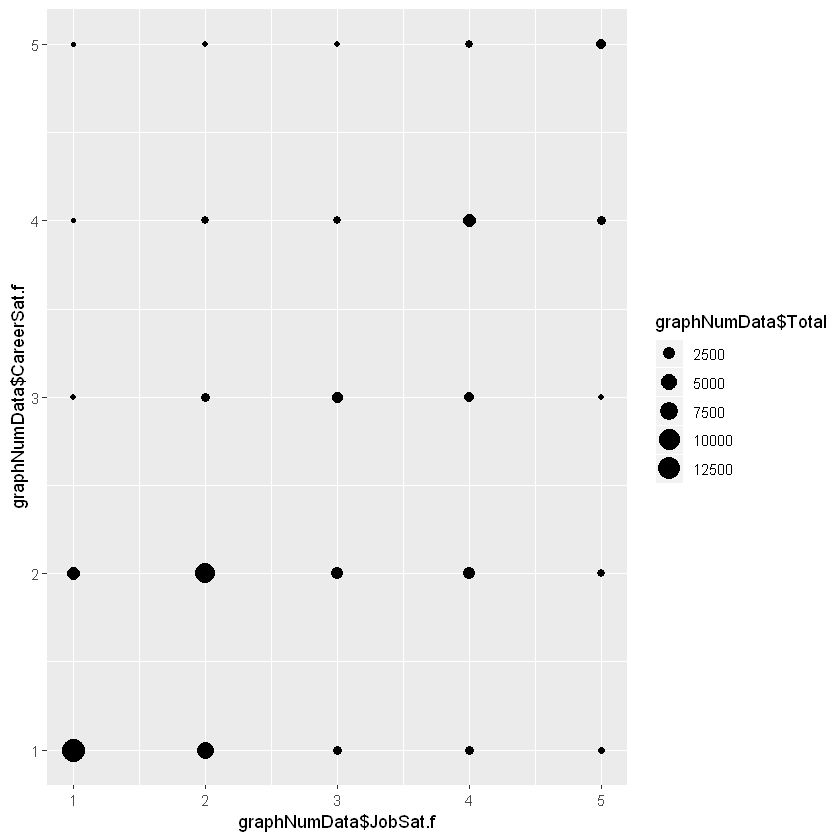

In [22]:
graphNumData <- cleanNumericData2019 %>% 
    group_by(JobSat.f, CareerSat.f) %>% 
        summarize(Total = n())

ggplot(data = graphNumData, mapping = aes(x = graphNumData$JobSat.f, y = graphNumData$CareerSat.f, size = graphNumData$Total)) +
  geom_point()

From the above ggplot we can see that respondents who are highly satisfied with their job are also highly satisfied with their carreer and this patterns is preserved throughout the rest of the satisfaction levels.  

In order to find the correlations between different variables, we decided to make use of the cor() function in order to computer a correlation matrix between all the values cleaned and chosen from the dataset. 

In [23]:
correlationMatrix <- round(cor(cleanNumericData2019), 3)
correlationMatrix

,JobSat.f,CareerSat.f,OrgSize.f,YearsCode,Age1stCode,Age,GenderMale,GenderFemale,GenderOther,Angular,Vue,Ruby,React,Laravel,Flask,Express,Drupal,Django,ASP,jQuery
JobSat.f,1.000,0.628,-0.016,-0.033,0.030,-0.011,0.011,-0.016,0.010,0.002,-0.012,-0.027,-0.040,0.027,-0.010,-0.004,0.015,0.000,0.009,0.029
CareerSat.f,0.628,1.000,0.033,-0.023,0.027,-0.005,-0.003,-0.006,0.023,-0.007,-0.015,-0.022,-0.045,0.034,-0.009,-0.017,0.019,0.002,-0.009,0.028
OrgSize.f,-0.016,0.033,1.000,-0.010,0.003,-0.007,0.014,-0.019,0.009,-0.040,0.084,0.034,0.013,0.135,-0.028,0.030,0.034,0.034,-0.043,0.082
YearsCode,-0.033,-0.023,-0.010,1.000,-0.329,0.752,0.090,-0.093,-0.009,-0.025,-0.029,-0.007,-0.062,-0.079,-0.020,-0.084,0.030,-0.041,0.078,-0.009
Age1stCode,0.030,0.027,0.003,-0.329,1.000,0.002,-0.074,0.086,-0.018,0.009,-0.027,-0.006,-0.023,0.026,-0.034,-0.003,-0.001,-0.019,-0.009,0.034
Age,-0.011,-0.005,-0.007,0.752,0.002,1.000,0.039,-0.035,-0.017,-0.039,-0.052,-0.003,-0.080,-0.085,-0.047,-0.100,0.033,-0.056,0.075,-0.006
GenderMale,0.011,-0.003,0.014,0.090,-0.074,0.039,1.000,-0.922,-0.360,0.012,0.019,-0.043,-0.033,0.027,0.009,0.019,-0.015,0.000,0.033,-0.009
GenderFemale,-0.016,-0.006,-0.019,-0.093,0.086,-0.035,-0.922,1.000,-0.028,-0.010,-0.024,0.039,0.027,-0.028,-0.016,-0.024,0.013,-0.007,-0.027,0.010
GenderOther,0.010,0.023,0.009,-0.009,-0.018,-0.017,-0.360,-0.028,1.000,-0.007,0.010,0.017,0.019,0.000,0.014,0.008,0.007,0.018,-0.020,0.000
Angular,0.002,-0.007,-0.040,-0.025,0.009,-0.039,0.012,-0.010,-0.007,1.000,0.033,-0.033,0.000,0.005,-0.052,0.126,0.023,-0.033,0.115,0.062


Since this correlation matrix contains a lot of data, it will be easier to observe the correlations if we will make use of heat maps on the computed correlationMatrix variable.

The following cells present two types of heat maps. 
The first heat map is showing a diagonal white line which represents a perfect correlation. This perfect correlation appears between the same variables since these are taken on both x and y axes in order to display the correlations. 
The second heat map shows the same correlations just that in a clearer manner, label wise.
Since the labels of our columns are lengthy, the first heat map is excelent on showing the colors of the correlations based on the legend while the second heat map shows the correlation coefficient placement on the legend more clear.


Attaching package: 'reshape2'

The following object is masked from 'package:tidyr':

    smiths




  There is a binary version available but the source version is later:
      binary source needs_compilation
Hmisc  4.2-0  4.3-0              TRUE

  Binaries will be installed
package 'Hmisc' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\kucer\AppData\Local\Temp\RtmpGWXR6d\downloaded_packages
package 'corrplot' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\kucer\AppData\Local\Temp\RtmpGWXR6d\downloaded_packages


corrplot 0.84 loaded


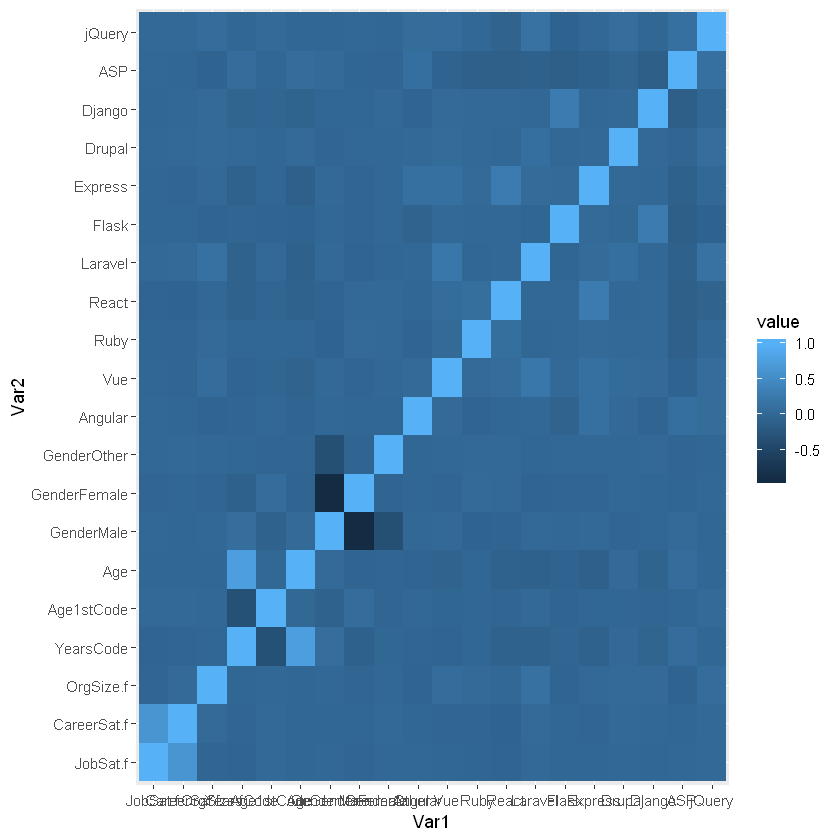

In [24]:
# need to install a ggplot2 and reshape2 libraries to create the heatmap
library(ggplot2)
library(reshape2)
install.packages("Hmisc")
install.packages("corrplot")
library(corrplot)

meltedCorrelationMatrix <- melt(correlationMatrix)

ggplot(data = meltedCorrelationMatrix, aes(x=Var1, y=Var2, fill=value)) + 
  geom_tile()

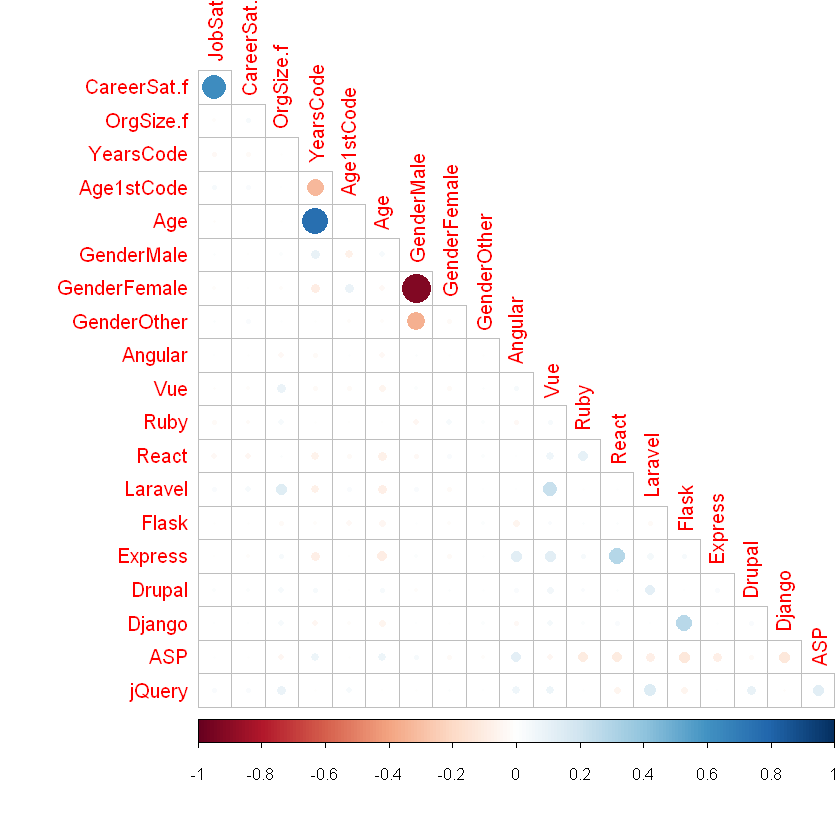

In [25]:
corrplot(correlationMatrix,diag = FALSE, type="lower")

Despite cleaning and including many values which we considered to have an impact on the job / career satisfaction levels, we can clearly see from the above matrix and heat maps that the only significant correlation is just between career satisfaction and job satisfaction. 
It is not a perfect correlation, hence we cannot exclude it, yet we feel this is not really saying much since we aimed at finding values/ factors which would help in explaining both job and career satisfaction. 

Other remarks from these heatmaps are that genderMale and genderFemale are in a close to perfect negative correlation which is triggered by the fact that an observation is most likely to be either male or female. GenderOther appeares to be less likely to be GenderMale based on a negative correlation coeficient of -0.360.
Other weak correlations can be seen among some of the frameworks, which can be explained by the similarity of the frameworks or by these being based on the same underlying technology. 

 <font color='red'>In the last cell of this section, we are re-calculating the correlation coefficient between JobSat and CareerSat column and proving that it shows the same value as in the correlation matrix. We are also running the linear model function and presenting the model's summary.</font>

In [26]:
cor(cleanNumericData2019$JobSat.f, cleanNumericData2019$CareerSat.f,  method = "pearson", use = "complete.obs")
model <- lm(formula = CareerSat.f ~ ., data = cleanNumericData2019)
summary(model)

[1] 0.6284398


Call:
lm(formula = CareerSat.f ~ ., data = cleanNumericData2019)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9000 -0.4244 -0.1693  0.4469  3.8824 

Coefficients: (1 not defined because of singularities)
               Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.7606411  0.0461228  16.492  < 2e-16 ***
JobSat.f      0.5849215  0.0032473 180.127  < 2e-16 ***
OrgSize.f     0.0235791  0.0020077  11.744  < 2e-16 ***
YearsCode    -0.0003619  0.0008353  -0.433  0.66482    
Age1stCode    0.0013550  0.0009849   1.376  0.16890    
Age           0.0004390  0.0008756   0.501  0.61611    
GenderMale   -0.1888588  0.0389917  -4.844 1.28e-06 ***
GenderFemale -0.1671424  0.0418247  -3.996 6.44e-05 ***
GenderOther          NA         NA      NA       NA    
Angular      -0.0098195  0.0088494  -1.110  0.26717    
Vue          -0.0373770  0.0116331  -3.213  0.00131 ** 
Ruby         -0.0265506  0.0147785  -1.797  0.07241 .  
React        -0.0428002  0.0091570  -4.674 2.96e-06 ***


## Building a Machine Learning Classification Model

In this section, we will create a model for supervised machine learning. In our case, we would like see whether the career satisfaction level can be inferred based on other variables from the previously cleaned dataset, even though we haven't found any other significant correlations so far. Since we know the career satisfaction levels, we will focus on supervised machine learning practices. Given the fact that our data are more of a categorical nature, we will create a classification model.

In [27]:
dim(cleanNumericData2019ForTree)

[1] 49951    20

In [28]:
set.seed(1234)
trainRows <- sample(1:nrow(cleanNumericData2019ForTree), 34966)
testRows <- setdiff(1:nrow(cleanNumericData2019ForTree), trainRows)
trainingData2019 <- cleanNumericData2019ForTree[trainRows, ]
testData2019 <- cleanNumericData2019ForTree[testRows, ]

In [29]:
library(rpart)

dataTree <- rpart(CareerSat ~ ., trainingData2019) 
summary(dataTree)

Call:
rpart(formula = CareerSat ~ ., data = trainingData2019)
  n= 34966 

          CP nsplit rel error    xerror        xstd
1 0.23227147      0 1.0000000 1.0000000 0.004443009
2 0.01372843      1 0.7677285 0.7677285 0.004500563
3 0.01000000      4 0.7246580 0.7246580 0.004473405

Variable importance
    JobSat Age1stCode 
        98          1 

Node number 1: 34966 observations,    complexity param=0.2322715
  predicted class=1  expected loss=0.5916319  P(node) =1
    class counts: 14279 12119  3285  3537  1746
   probabilities: 0.408 0.347 0.094 0.101 0.050 
  left son=2 (10931 obs) right son=3 (24035 obs)
  Primary splits:
      JobSat     splits as  LRRRRR,     improve=3245.86600, (0 missing)
      React      < 0.5    to the right, improve=  30.36299, (0 missing)
      Age1stCode < 24.5   to the right, improve=  18.45731, (0 missing)
      Age        < 56.5   to the right, improve=  17.64173, (0 missing)
      YearsCode  < 35.5   to the right, improve=  13.87695, (0 missing)
  S

package 'rpart.plot' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\kucer\AppData\Local\Temp\RtmpGWXR6d\downloaded_packages


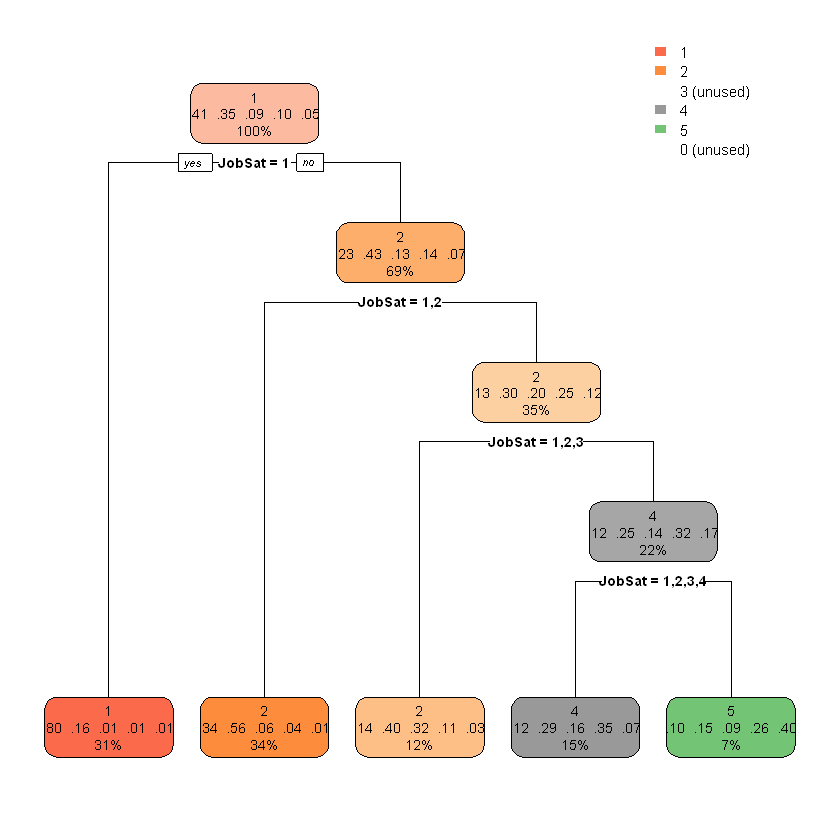

In [30]:
install.packages("rpart.plot")
library(rpart.plot)

rpart.plot(dataTree)

After installing the Hmisc library and requesting a correlation index between all the variables we chose to look at, we obviously observed a perfect correlation value of 1 between the same values, which is to be expected when using this approach, yet most of the categories do not seem to have a correlation with Career satosfaction nor job satisfaction.

The expected correlation between job and career satisfaction is confirmed here, but unfortunately we cannot really make use of this information because career satisfaction and job satisfaction can mean the same thing for many respondends.

We also tested the relationship between these values against a decision tree, hence making use of the 7:3 ratio where aproximately 70% of this data is taken as training data for the model and 30% is test data.

Therefore we chose to not look into this correlation, and we can conclude that so far we could not see what other factor from this data set can have a significant impact on a technical person's job satisfaction.

## Evaluating the Model and the Results Obtained

predictCareerSat <- predict(dataTree, newdata = testData2019, type = "class")
table(predictCareerSat, testData2019$CareerSat)

Correct - 8.497 

Incorrect - 6.488

Total - 49.951 with 34.966 for training set

Approx. 56,7% cases of predictions were correct. 

In the cells above, we present the prediction matrix for different career satisfaction levels. As we can see, approximately 75% of cases were predicted correctly, which is quite remarkable given the lack of training data. However, since there were no attributes other than job satisfaction that would influence the carreer satisfation levels, it is definitely not a satisfactory result. The job and career satisfaction correlate well since there seem to be a trend in people being satisfied with their jobs when they are satisfied with their carreers and vice versa. Some people might even misunderstood the difference althogether. 

Therefore, even though we managed to predict the career levels, the correlation is very obvious and we didn't find any surprising results that would be worth mentioning. It is not impossible that in our dataset, given the fact it contained more than 80 columns, there could be some hidden attributes that would predict the career or job satisfaction. This would require us to clean the whole dataset and try to find some other correlations among the variables, which we unfortunately didn't have the time for. 

Not enough data after cleaning - too many NA values and the dataset ended up being quite small for machine learning after the cleaning. There was also a number of dishonest answers, as we could see from the comparison of people's age and the number of years they have been coding. 

Big data - better to have a database, we could use more data obtained over time

GDPR - even thouth the survey contains some data which might be considered personal, it's still not possible to link the data in a way which would point to a specific indivisual and therefore we don't hae issues.